# Imports

## Packages

In [60]:
import pandas as pd
import datetime as dt
# from datetime import datetime, timezone
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from entsoe import EntsoePandasClient
from statsmodels.graphics import tsaplots

In [61]:
pip install "dvc[gdrive]"

## Data

In [62]:
# Load the data into a Pandas DataFrame
df = pd.read_csv('clean.csv')
df['Timestamp'] = pd.to_datetime(df['Timestamp'], format = '%Y %m %d %H:%M:%S')
df.head()

,Timestamp,DK_1_imports,SE_4_imports,DK_1_exports,SE_4_exports,Day_Ahead_price,Forecasted_Load,Actual_Load,Solar_[MW],ttf_price,...,Year,Quarter,Month,Date,Day,Weekday,Hour,Week,business,Wind Total
0,2018-01-02 00:00:00,383.0,0.0,0.0,808.0,18.12,1258.0,1245.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,0,1,True,429.0
1,2018-01-02 01:00:00,589.0,0.0,0.0,1019.0,14.99,1188.0,1203.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,1,1,True,375.0
2,2018-01-02 02:00:00,557.0,0.0,0.0,926.0,17.79,1167.0,1178.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,2,1,True,313.0
3,2018-01-02 03:00:00,487.0,0.0,0.0,784.0,24.51,1187.0,1180.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,3,1,True,229.0
4,2018-01-02 04:00:00,580.0,0.0,0.0,756.0,17.82,1235.0,1247.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,4,1,True,175.0


In [63]:
df_elMaps2021 = pd.read_csv('clean_lagged(1).csv')
df_elMaps2021['Timestamp'] = pd.to_datetime(df['Timestamp'], format = '%Y %m %d %H:%M:%S')
df_elMaps2021.tail()

,Timestamp,DK_1_imports,SE_4_imports,DK_1_exports,SE_4_exports,Day_Ahead_price,Forecasted_Load,Actual_Load,Solar_[MW],ttf_price,...,Hour,Week,business,Wind Total,DAP-lag24,DAP-lag36,DAP-lag48,DAP-lag72,DAP-lag168,DAP-lag-168
45952,2023-03-31 19:00:00,0.0,1198.0,257.0,0.0,135.07,1537.0,1511.0,1.0,43.125,...,19,14,True,260.0,118.49,155.96,191.68,177.32,48.08,151.00
45953,2023-03-31 20:00:00,0.0,1199.0,279.0,0.0,135.00,1487.0,1469.0,0.0,43.125,...,20,14,True,379.0,114.16,129.45,164.98,155.56,40.93,134.33
45954,2023-03-31 21:00:00,0.0,1274.0,456.0,0.0,136.32,1422.0,1392.0,0.0,43.125,...,21,14,True,504.0,109.00,114.63,151.39,141.19,35.85,82.61
45955,2023-03-31 22:00:00,0.0,1272.0,559.0,0.0,126.07,1360.0,1323.0,0.0,43.125,...,22,14,True,535.0,88.15,105.10,139.13,129.93,30.04,123.90
45956,2023-03-31 23:00:00,0.0,1211.0,600.0,0.0,75.18,1273.0,1312.0,0.0,43.125,...,23,14,True,897.0,59.52,104.02,135.54,127.51,39.58,112.00


In [64]:
df.columns


Index(['Timestamp', 'DK_1_imports', 'SE_4_imports', 'DK_1_exports',
       'SE_4_exports', 'Day_Ahead_price', 'Forecasted_Load', 'Actual_Load',
       'Solar_[MW]', 'ttf_price', 'coal_price', 'co2_price',
       'Biomass_Actual_Aggregated_[MW]', 'Waste_Actual_Aggregated_[MW]',
       'DE_LU_AT_imports', 'DE_LU_AT_exports', 'Year', 'Quarter', 'Month',
       'Date', 'Day', 'Weekday', 'Hour', 'Week', 'business', 'Wind Total'],
      dtype='object')

In [57]:

df_2023 = df.copy()

In [71]:
df_2023.columns

Index(['Timestamp', 'DK_1_imports', 'SE_4_imports', 'DK_1_exports',
       'SE_4_exports', 'Day_Ahead_price', 'Forecasted_Load', 'Actual_Load',
       'Solar_[MW]', 'ttf_price', 'coal_price', 'co2_price',
       'Biomass_Actual_Aggregated_[MW]', 'Waste_Actual_Aggregated_[MW]',
       'DE_LU_AT_imports', 'DE_LU_AT_exports', 'Year', 'Quarter', 'Month',
       'Date', 'Day', 'Weekday', 'Hour', 'Week', 'business', 'Wind Total'],
      dtype='object')

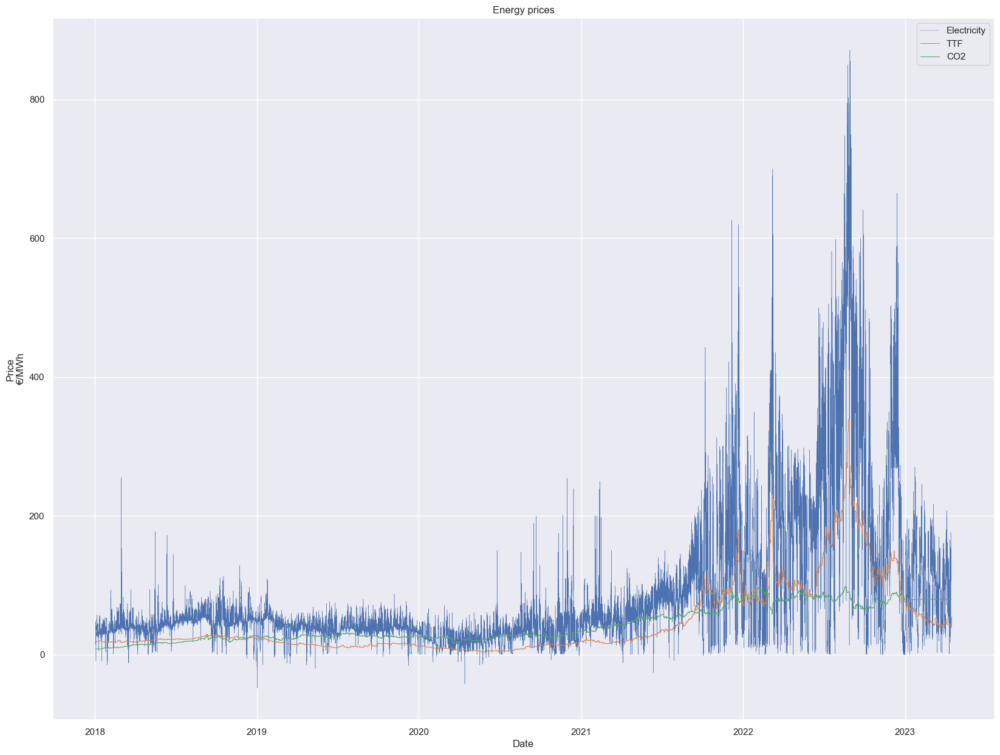

In [68]:
# Line chart of electricity price over time
plt.figure(figsize = (20,15))
plt.plot(df['Timestamp'], df_2023['Day_Ahead_price'], linestyle = '-', linewidth = 0.3, label = 'Electricity')
plt.plot(df['Timestamp'], df_2023['ttf_price'], linestyle = '-', linewidth = 0.8, label = 'TTF')
plt.plot(df['Timestamp'], df_2023['co2_price'], linestyle = '-', linewidth = 0.8, label = 'CO2')
plt.legend()
plt.title('Energy prices')
plt.xlabel('Date')
plt.ylabel('Price\n€/MWh')
plt.show()

In [69]:
df2 = df.copy()

months = df['Month'].unique()
quarters = df['Quarter'].unique()
years = [2018, 2019, 2020, 2021, 2022]

In [70]:
df2.head()

,Timestamp,DK_1_imports,SE_4_imports,DK_1_exports,SE_4_exports,Day_Ahead_price,Forecasted_Load,Actual_Load,Solar_[MW],ttf_price,...,Year,Quarter,Month,Date,Day,Weekday,Hour,Week,business,Wind Total
0,2018-01-02 00:00:00,383.0,0.0,0.0,808.0,18.12,1258.0,1245.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,0,1,True,429.0
1,2018-01-02 01:00:00,589.0,0.0,0.0,1019.0,14.99,1188.0,1203.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,1,1,True,375.0
2,2018-01-02 02:00:00,557.0,0.0,0.0,926.0,17.79,1167.0,1178.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,2,1,True,313.0
3,2018-01-02 03:00:00,487.0,0.0,0.0,784.0,24.51,1187.0,1180.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,3,1,True,229.0
4,2018-01-02 04:00:00,580.0,0.0,0.0,756.0,17.82,1235.0,1247.0,0.0,19.32,...,2018,1,1,2018-01-02,2,1,4,1,True,175.0


In [72]:
import matplotlib.pyplot as plt

import matplotlib.ticker as ticker

import plotly.express as px

In [79]:
list_years = list(set(df['Year']))

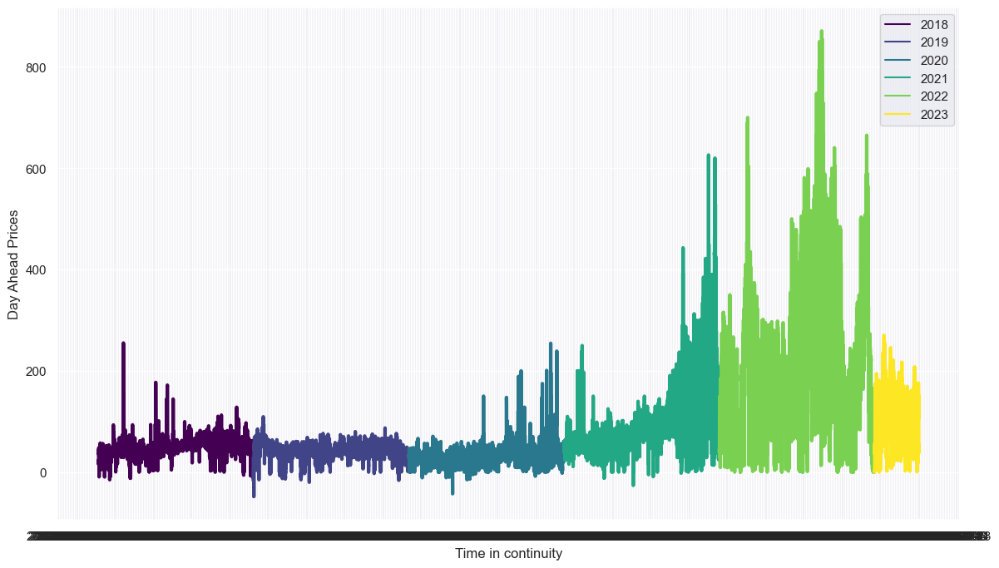

In [75]:
sns.set_style('darkgrid')
sns.set(rc={'figure.figsize':(14,8)})

ax = sns.lineplot(data=df, x ='Timestamp', y = 'Day_Ahead_price',
                  hue='Year', palette='viridis',
                  legend='full', lw=3)

ax.xaxis.set_major_locator(ticker.MultipleLocator(4))
plt.legend(bbox_to_anchor=(1, 1))
plt.ylabel('Day Ahead Price')
plt.xlabel('Time in continuity')
plt.show()

### This is an interactive graph so you can click on each year to remove or add it and see what point in time you want.

In [84]:
# Import the necessaries libraries
import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()

In [85]:
import plotly.graph_objects as go

#extract color palette, the palette can be changed
pal = list(sns.color_palette(palette='viridis', n_colors=len(list_years)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Day_Ahead_price'],
                             name = d,
                             line_color = p, 
                             fill=None))   #tozeroy 
    


fig.show()

In [89]:
pal1 = list(sns.color_palette(palette='viridis', n_colors=len(list_years)).as_hex())
pal2 = list(sns.color_palette(palette='YlOrBr', n_colors=len(list_years)).as_hex())
pal3 = list(sns.color_palette(palette='plasma', n_colors=len(list_years)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Actual_Load'],
                             name = str(d) + " Actual Load",
                             line_color = p, 
                             fill=None))   #tozeroy 
    

for d,p in zip(list_years, pal2):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Wind Total'],
                             name = str(d) + ' Wind Total',
                             line_color = p, 
                             fill=None))   #tozeroy 

for d,p in zip(list_years, pal3):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Solar_[MW]'],
                             name = str(d) + ' Solar',
                             line_color = p, 
                             fill=None))   #tozeroy 
    
for d,p in zip(list_years, pal2):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Biomass_Actual_Aggregated_[MW]'],
                             name = str(d) + ' Biomass Renewable',
                             line_color = p, 
                             fill=None))   #tozeroy

for d,p in zip(list_years, pal1):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Waste_Actual_Aggregated_[MW]'],
                             name = str(d) + ' Waste Renewable',
                             line_color = p, 
                             fill=None))   #tozeroy 
    


fig.show()

## Creating a new dataframe with all the renewable sources and the Actual Load of the Electricity Network

In [91]:
df_renew = df[['Timestamp','Year','Wind Total','Solar_[MW]','Biomass_Actual_Aggregated_[MW]',
              'Waste_Actual_Aggregated_[MW]','Actual_Load']].copy()

In [93]:
df_renew.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46313 entries, 0 to 46312
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Timestamp                       46313 non-null  datetime64[ns]
 1   Year                            46313 non-null  int64         
 2   Wind Total                      46313 non-null  float64       
 3   Solar_[MW]                      46313 non-null  float64       
 4   Biomass_Actual_Aggregated_[MW]  46313 non-null  float64       
 5   Waste_Actual_Aggregated_[MW]    46313 non-null  float64       
 6   Actual_Load                     46313 non-null  float64       
dtypes: datetime64[ns](1), float64(5), int64(1)
memory usage: 2.5 MB


In [96]:
df_renew['Total Renewable'] = (df_renew['Wind Total'] 
                               + df_renew['Solar_[MW]'] 
                               + df_renew['Biomass_Actual_Aggregated_[MW]'] 
                               + df_renew['Waste_Actual_Aggregated_[MW]'])

In [97]:
#i

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


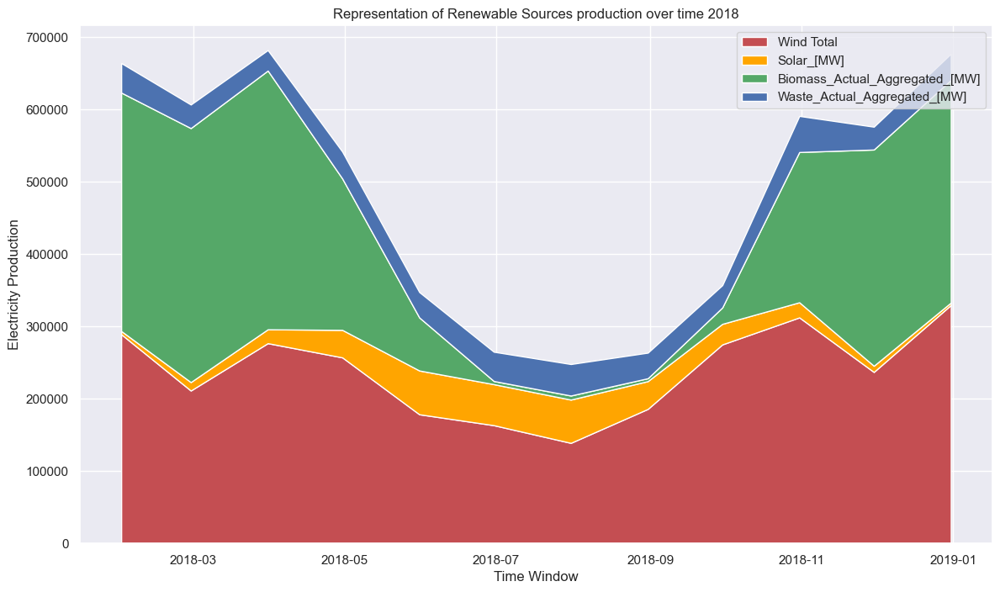

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


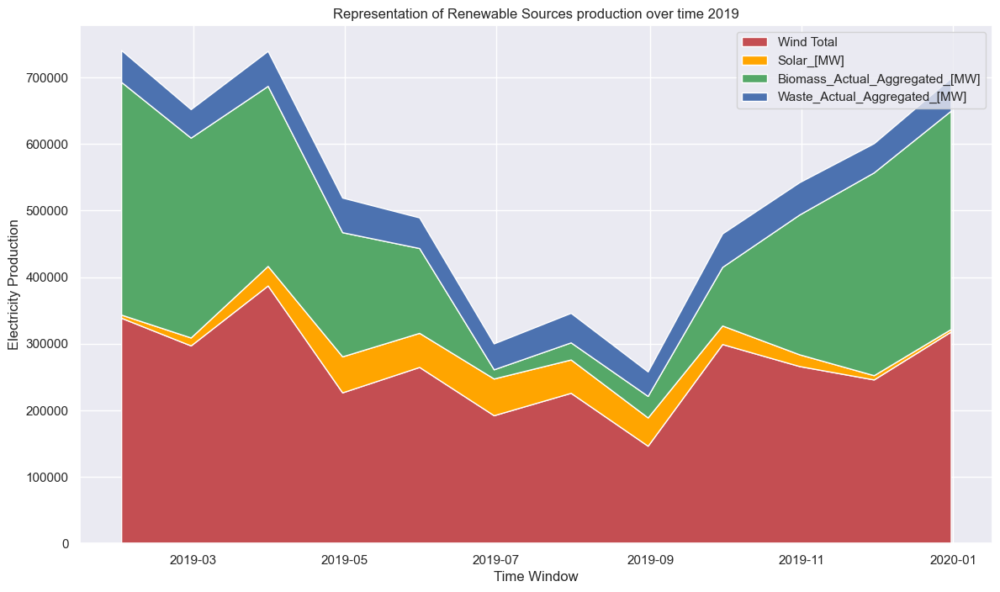

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


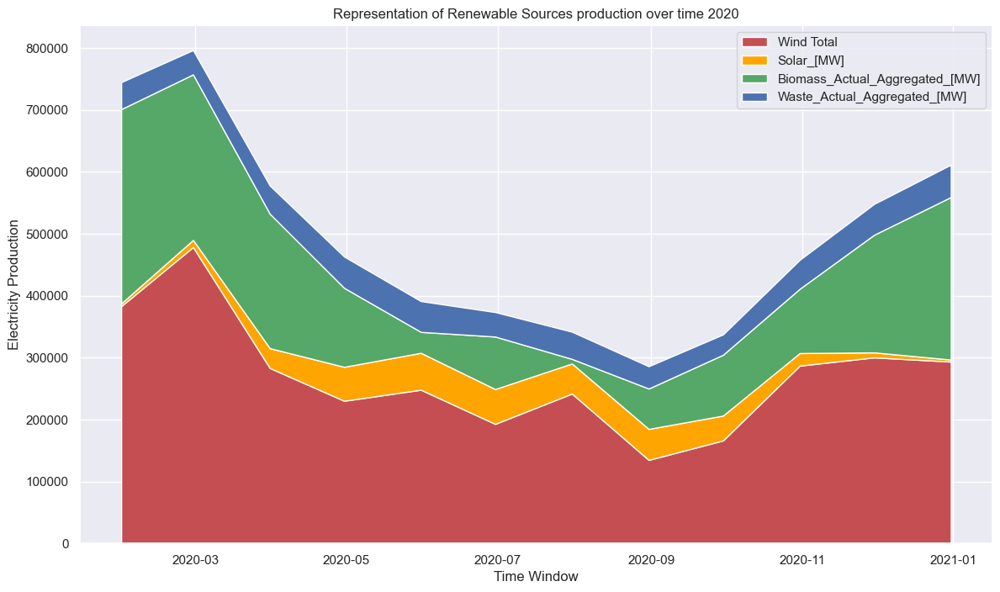

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


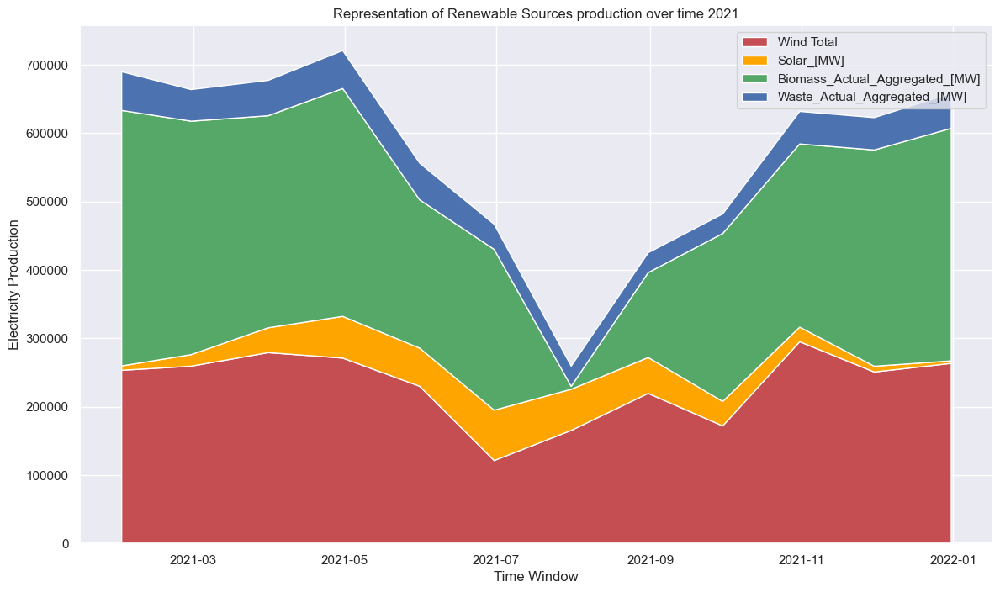

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


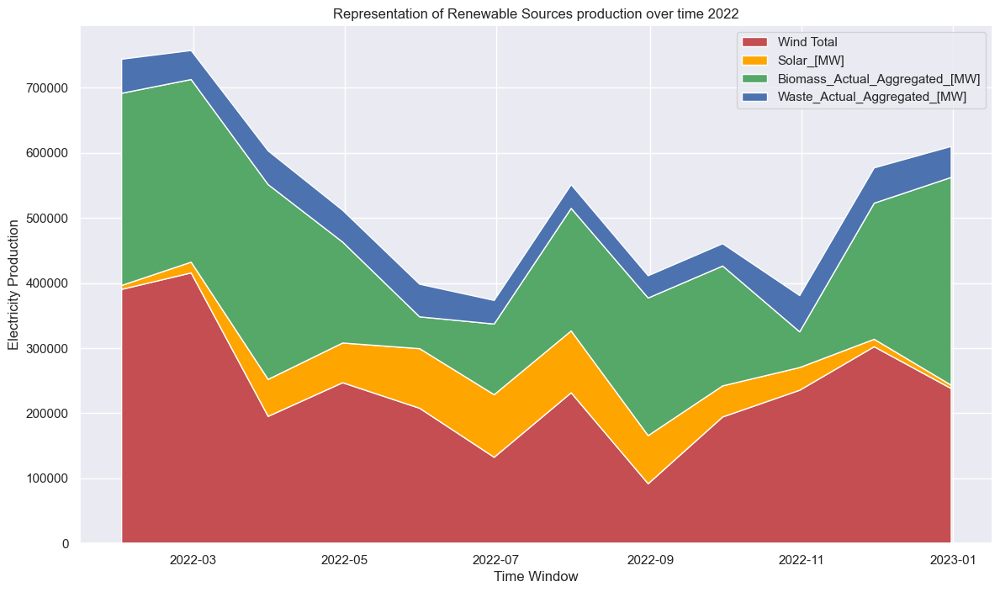

In [116]:

for yr in years:
        df_temp = df_renew[df_renew['Year'] == yr]
        df_temp.set_index('Timestamp',inplace = True)
        i = df_temp.groupby(pd.Grouper(freq="M")).sum()
    # Stackplot with X, Y, colors value
        plt.stackplot(i.index, i['Wind Total'], i['Solar_[MW]'],
                    i['Biomass_Actual_Aggregated_[MW]'], i['Waste_Actual_Aggregated_[MW]'],
                      colors =['r','orange','g','b'])

    # Days
        plt.xlabel('Time Window')

    # Production
        plt.ylabel('Electricity Production')
        plt.legend()
    # Title of Graph
        plt.title('Representation of Renewable Sources production over time ' +str(yr))

    # Displaying Graph
        plt.legend(i.columns[1:])
        plt.show()

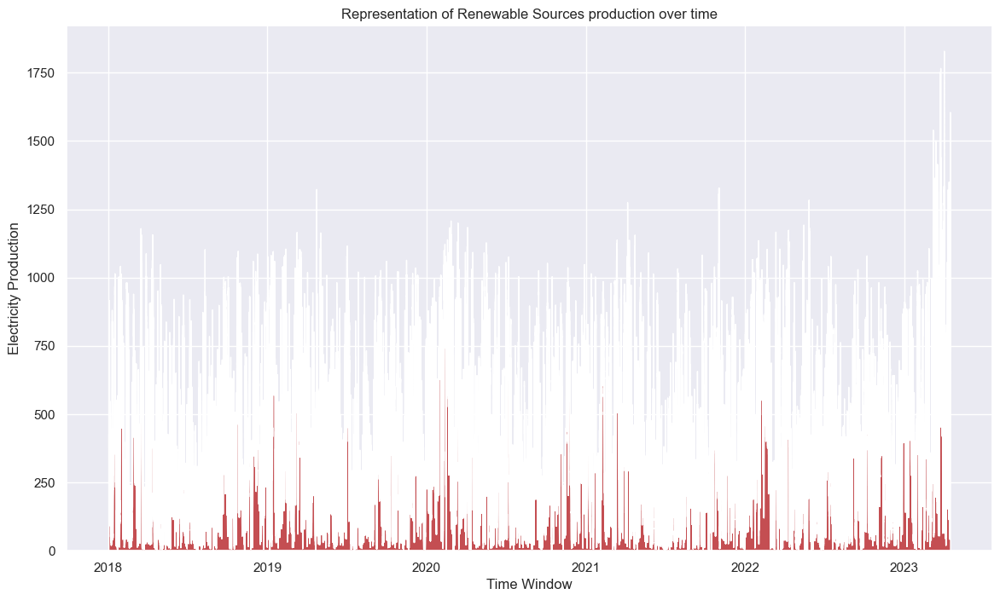

In [118]:
import matplotlib.pyplot as plt
 
# Stackplot with X, Y, colors value
plt.stackplot(df_renew['Timestamp'], df_renew['Wind Total'], df_renew['Solar_[MW]'],
              colors =['r', 'g'])
 
# Days
plt.xlabel('Time Window')
 
# No of hours
plt.ylabel('Electricity Production')
 
# Title of Graph
plt.title('Representation of Renewable Sources production over time')
 
# Displaying Graph
plt.show()

In [28]:
def mask_with_values_loc(df):
    mask = df_renew['Year'].values == '2019'
    return df.loc[mask]

In [119]:
list_years2 = list(set(df_elMaps2021['Year']))

In [121]:
df_re_2018 = df_renew[df_renew['Year'] == 2018].copy()
df_re_2019 = df_renew[df_renew['Year'] == 2019].copy()
df_re_2020 = df_renew[df_renew['Year'] == 2020].copy()
df_re_2021 = df_renew[df_renew['Year'] == 2021].copy()

In [126]:
pal = list(sns.color_palette(palette='viridis', n_colors=len(list_years)).as_hex())
pal2 = list(sns.color_palette(palette='Spectral', n_colors=len(list_years)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal):
    fig.add_trace(go.Scatter(x = df[df['Year']==d]['Timestamp'],
                             y = df[df['Year']==d]['Actual_Load'],
                             name = 'Actual Load needed of year ' + str(d),
                             line_color = p, 
                             fill=None))   #tozeroy 
    

for d,p in zip(list_years, pal2):
    fig.add_trace(go.Scatter(x = df_renew[df_renew['Year']==d]['Timestamp'],
                             y = df_renew[df_renew['Year']==d]['Total Renewable'],
                             name = 'Renewable Energy of ' + str(d),
                             line_color = p, 
                             fill=None))   #tozeroy
    


fig.show()

In [127]:
pal3 = list(sns.color_palette(palette='inferno', n_colors=len(list_years2)).as_hex())
pal4 = list(sns.color_palette(palette='viridis', n_colors=len(list_years2)).as_hex())

fig = go.Figure()

for d,p in zip(list_years2, pal4):
    fig.add_trace(go.Scatter(x = df_elMaps2021[df_elMaps2021['Year']==d]['Timestamp'],
                             y = df_elMaps2021[df_elMaps2021['Year']==d]['total_import_avg'],
                             name = str(d) +'Total Import',
                             line_color = p, 
                             fill='tozeroy'))   #tozeroy 
    
for d,p in zip(list_years, pal3):
    fig.add_trace(go.Scatter(x = df_elMaps2021[df_elMaps2021['Year']==d]['Timestamp'],
                             y = df_elMaps2021[df_elMaps2021['Year']==d]['total_export_avg'],
                             name = str(d) +'Total Export',
                             line_color = p, 
                             fill='tozeroy'))   #tozeroy 

fig.show()

KeyError: 'total_import_avg'

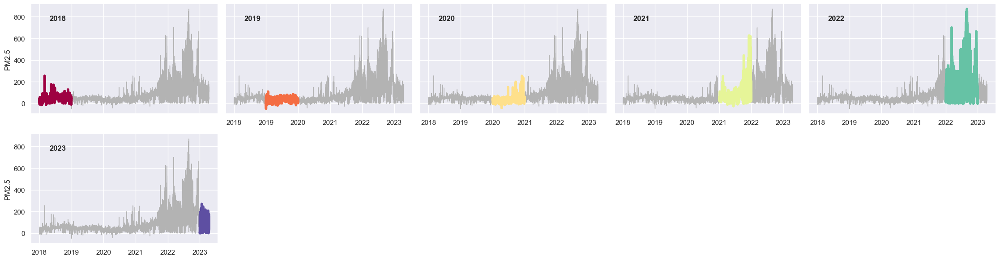

In [129]:
g = sns.relplot(data = df, x = "Timestamp", y = 'Day_Ahead_price',
                col = "Year", hue = "Year",
                kind = "line", palette = "Spectral",   
                linewidth = 4, zorder = 5,
                col_wrap = 5, height = 3, aspect = 1.5, legend = False
               )

#add text and silhouettes
for time, ax in g.axes_dict.items():
    ax.text(.1, .85, time,
            transform = ax.transAxes, fontweight="bold"
           )
    sns.lineplot(data = df, x = "Timestamp", y = 'Day_Ahead_price', units="Year",
                 estimator = None, color= ".7", linewidth=1, ax=ax
                )

g.set_titles("")
g.set_axis_labels("", "PM2.5")
g.tight_layout()

In [32]:
list_years2 = list(set(df_elMaps2021['Year']))

In [130]:

#extract color palette, the palette can be changed
pal = list(sns.color_palette(palette='viridis', n_colors=len(list_years2)).as_hex()) # Green-Blue

pal2 = list(sns.color_palette(palette='inferno', n_colors=len(list_years)).as_hex()) # Purple-Red


fig = go.Figure()
for d,p,p2 in zip(list_years, pal,pal2):
    fig.add_trace(go.Scatter(x = df_elMaps2021[df_elMaps2021['Year']==d]['Timestamp'],
                             y = df_elMaps2021[df_elMaps2021['Year']==d]['power_origin_percent_fossil_avg'],
                             name = d,
                             line_color = p, 
                             fill=None))   #tozeroy 
    
    fig.add_trace(go.Scatter(x = df_elMaps2021[df_elMaps2021['Year']==d]['Timestamp'],
                             y = df_elMaps2021[df_elMaps2021['Year']==d]['power_origin_percent_renewable_avg'],
                             name = d,
                             line_color = p2, 
                             fill=None))   #tozeroy 

    
fig.show()

KeyError: 'power_origin_percent_fossil_avg'

In [76]:
import plotly.graph_objects as go



#extract color palette, the palette can be changed
pal1 = list(sns.color_palette(palette='viridis', n_colors=len(list_years2)).as_hex())
pal2 = list(sns.color_palette(palette='viridis', n_colors=len(list_years2)).as_hex())

fig = go.Figure()
for d,p in zip(list_years, pal1):
    fig.add_trace(go.Scatter(x = df_elMaps2021[df_elMaps2021['Year']==d]['Timestamp'],
                             y = df_elMaps2021[df_elMaps2021['Year']==d]['total_import_avg'],
                             name = d,
                             line_color = p, 
                             fill=None))   #tozeroy 

    fig.add_trace(go.Scatter(x = df_elMaps2021[df_elMaps2021['Year']==d]['Timestamp'],
                             y = df_elMaps2021[df_elMaps2021['Year']==d]['total_export_avg'],
                             name = d,
                             line_color = p+3, 
                             fill=None))   #tozeroy 

    
fig.show()

TypeError: can only concatenate str (not "int") to str

In [131]:

# plotting the histogram
fig = px.histogram(df, x="Timestamp",y = 'Wind Total', color='Quarter',
                   nbins=50, histnorm='percent',
                   barmode='overlay')
 
# showing the plot
fig.show()

In [132]:
# plotting the histogram
fig = px.histogram(df, x="Timestamp",y = 'TTF', color='Month',
                   nbins=50, histnorm='percent',
                   barmode='overlay')
 
# showing the plot
fig.show()

ValueError: Value of 'y' is not the name of a column in 'data_frame'. Expected one of ['Timestamp', 'DK_1_imports', 'SE_4_imports', 'DK_1_exports', 'SE_4_exports', 'Day_Ahead_price', 'Forecasted_Load', 'Actual_Load', 'Solar_[MW]', 'ttf_price', 'coal_price', 'co2_price', 'Biomass_Actual_Aggregated_[MW]', 'Waste_Actual_Aggregated_[MW]', 'DE_LU_AT_imports', 'DE_LU_AT_exports', 'Year', 'Quarter', 'Month', 'Date', 'Day', 'Weekday', 'Hour', 'Week', 'business', 'Wind Total'] but received: TTF

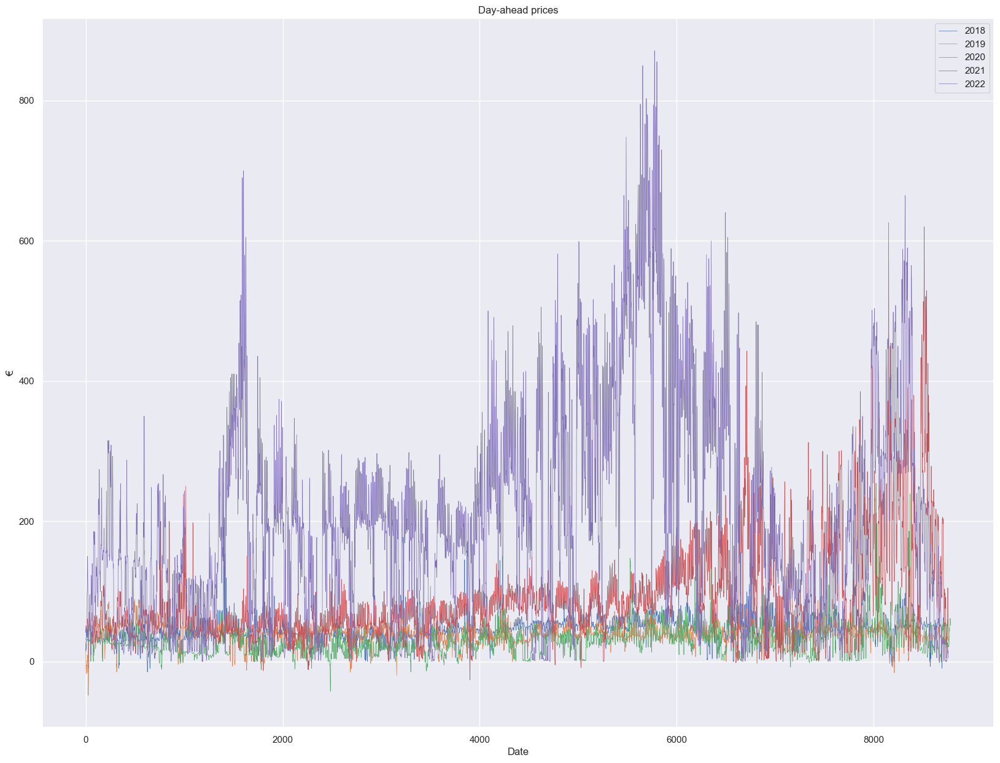

In [133]:
plt.figure(figsize = (20,15))
for yr in years:
    plt.plot(df2[df2['Year'] == yr].reset_index()['Day_Ahead_price'], linewidth = 0.5, label = yr)
plt.title('Day-ahead prices')
plt.xlabel('Date')
plt.ylabel('€')
plt.legend()
plt.show()

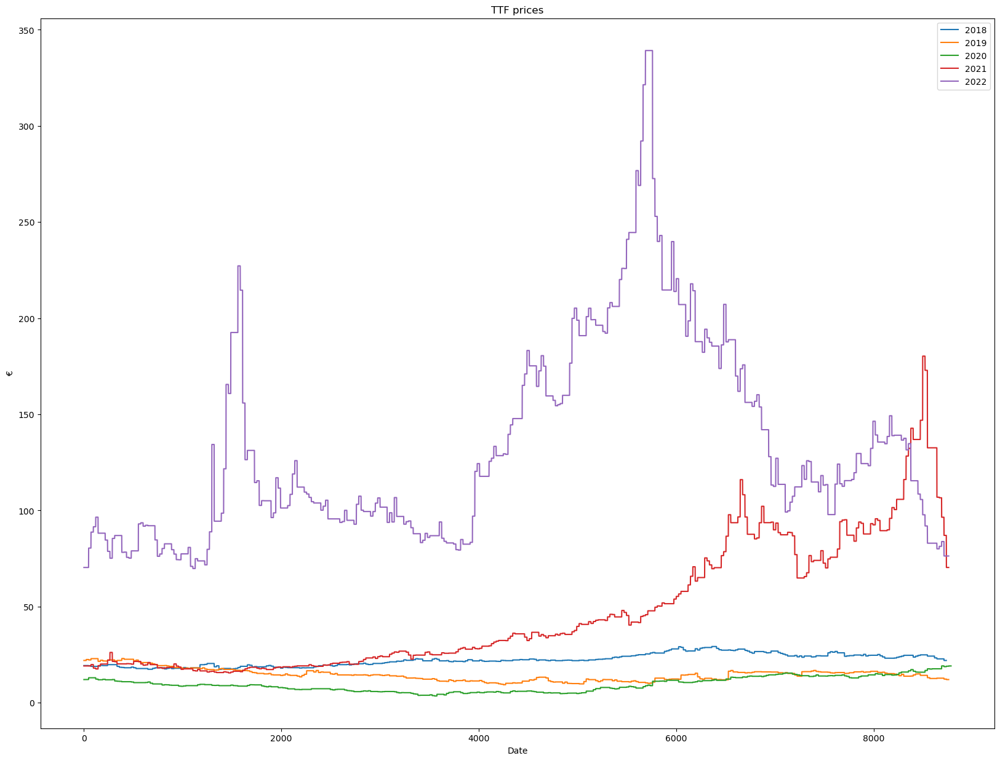

In [19]:
plt.figure(figsize = (20,15))
for yr in years:
    plt.plot(df2[df2['Year'] == yr].reset_index()['TTF'], label = yr)
plt.title('TTF prices')
plt.xlabel('Date')
plt.ylabel('€')
plt.legend()
plt.show()

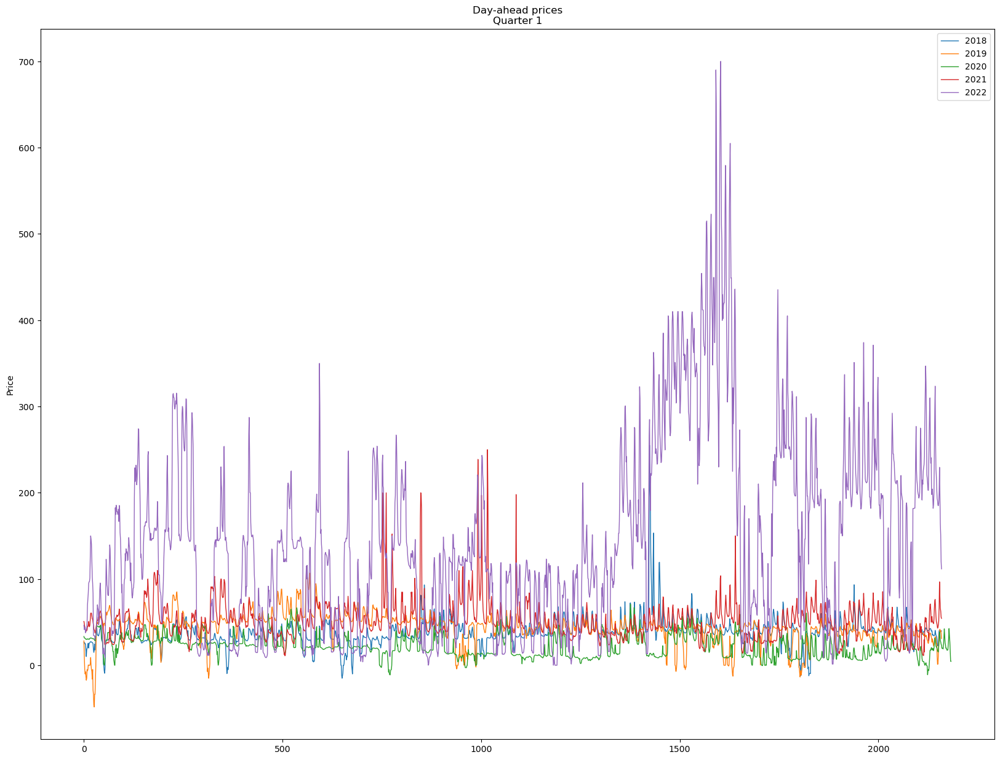

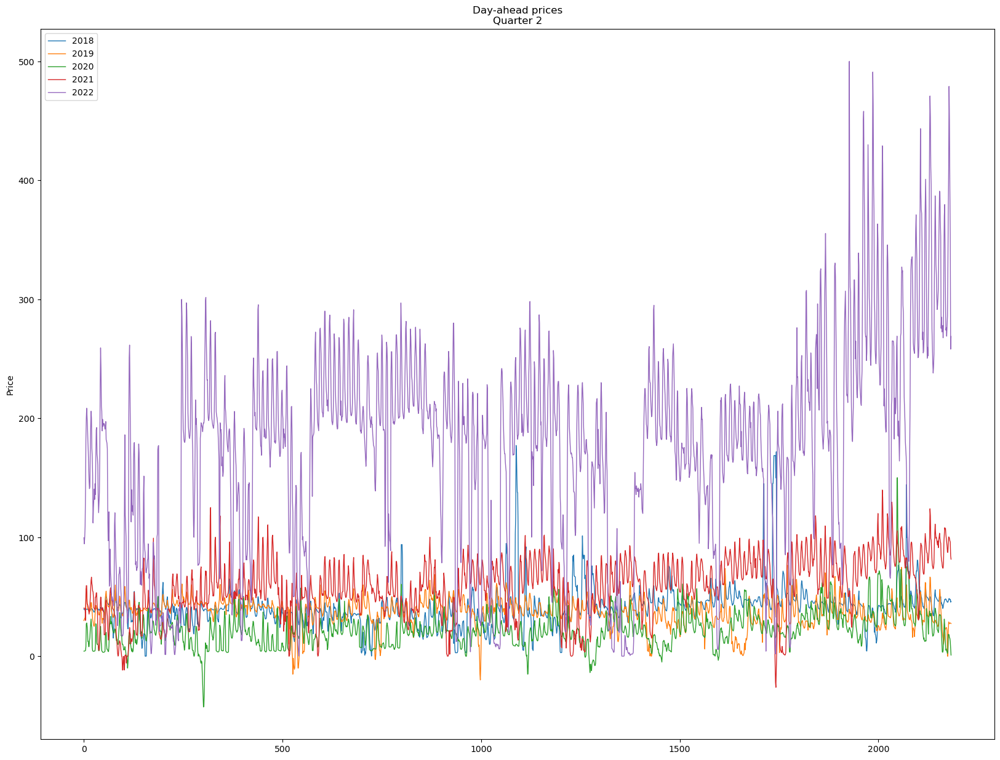

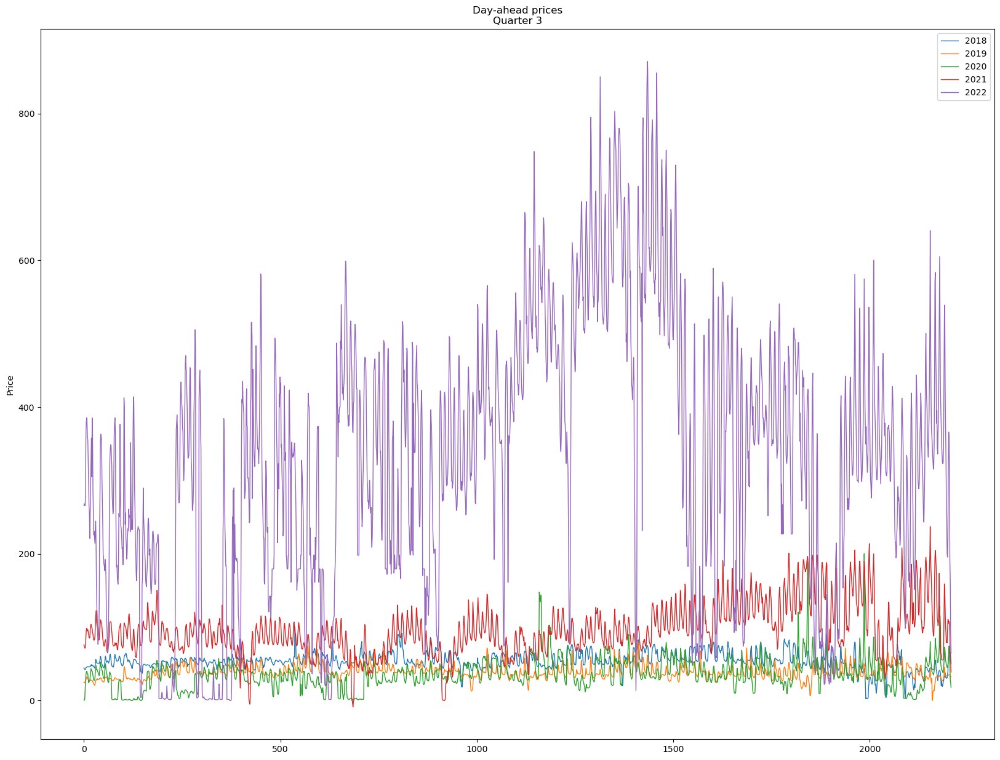

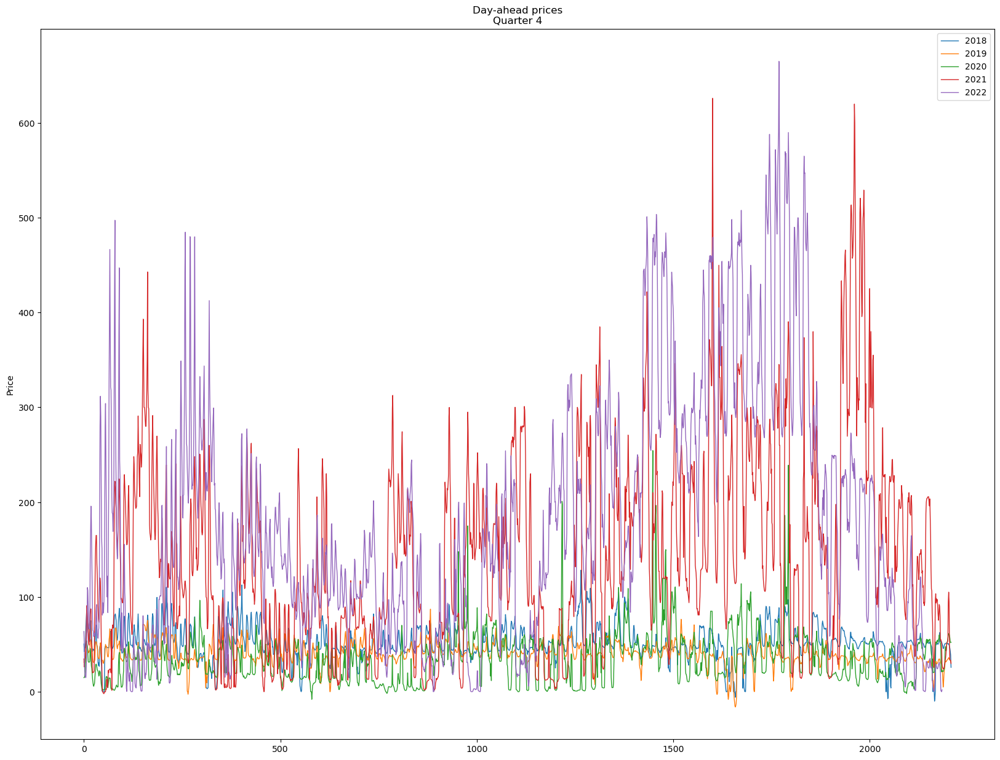

In [10]:
for q in quarters:
    plt.figure(figsize = (20,15))
    for y in years:
        temp = df2[(df2['Year'] == y) & (df2['Quarter'] == q)].reset_index()
        plt.plot(temp['Day-ahead prices'], linestyle = '-', linewidth = 1, label = y)
#         plt.plot(temp['Date'], temp['TTF'], linestyle = '-', linewidth = 0.8, label = 'TTF')
#         plt.plot(temp['Date'], temp['CO2'], linestyle = '-', linewidth = 0.8, label = 'CO2')
    plt.legend()
    plt.title('Day-ahead prices\nQuarter '+str(q))
    plt.ylabel('Price')
    plt.show()

In [11]:
cols = ['Day-ahead prices', 'TTF', 'CO2']
df3 = df2.groupby(by = 'Date')[cols].mean()
df3.reset_index(inplace = True)
df3.head()

,Date,Day-ahead prices,TTF,CO2
0,2018-01-01,23.972500,NaN,NaN
1,2018-01-02,32.287500,19.320,8.22
2,2018-01-03,21.706667,19.325,8.24
3,2018-01-04,35.558750,19.200,8.18
4,2018-01-05,38.096250,18.915,8.19


In [12]:
df2['Date'].dtype

dtype('<M8[ns]')

In [13]:
df3 = get_dt_info(df3, 'Date', yr = True, qt = True, mo = True, day = True)

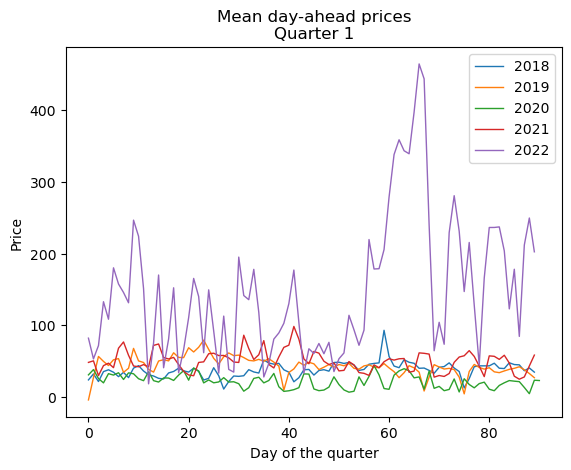

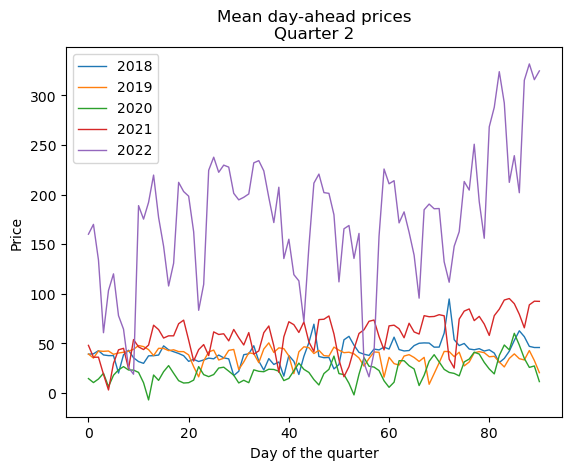

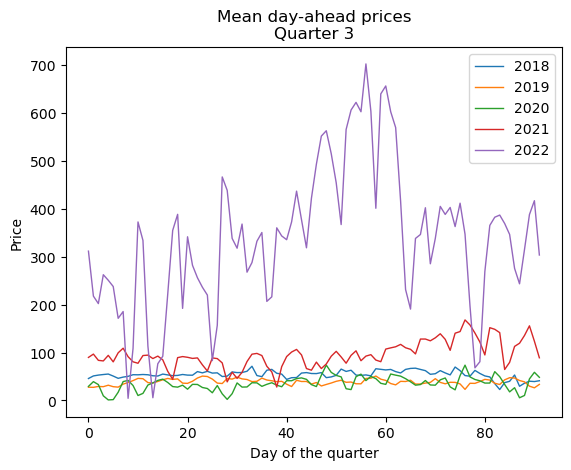

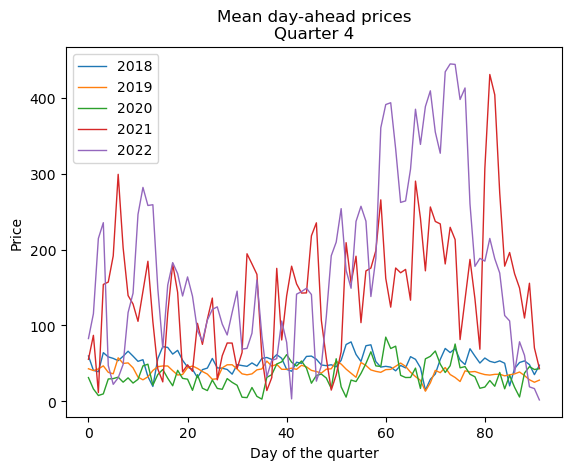

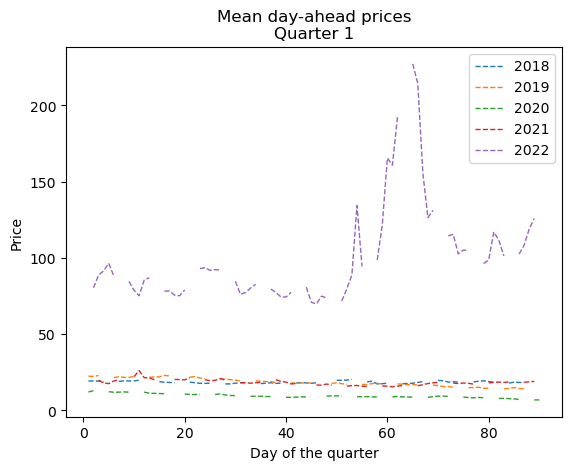

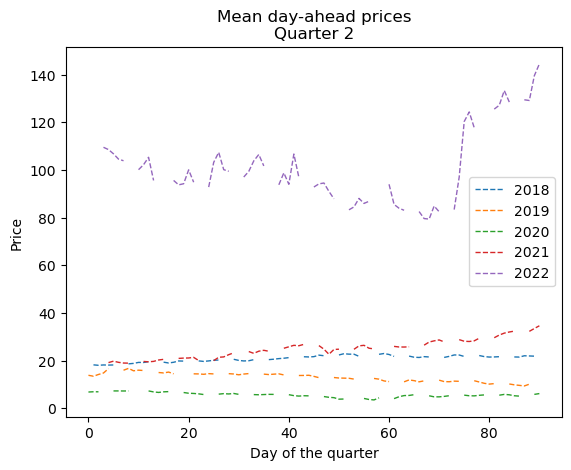

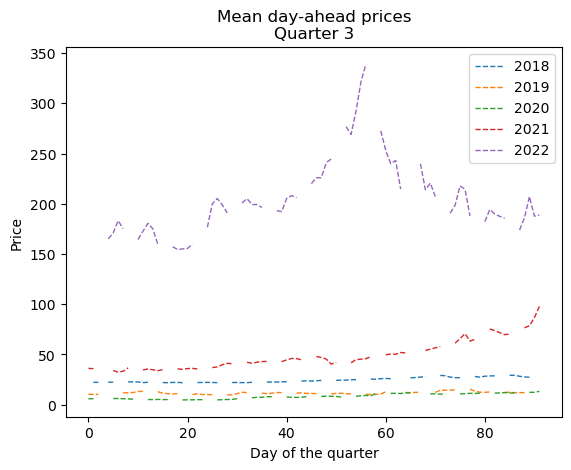

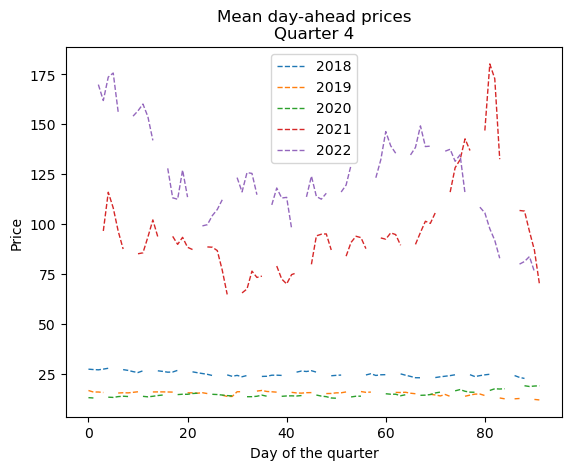

In [14]:
for q in quarters:
    for y in years:
        temp = df3[(df3['Year'] == y) & (df3['Quarter'] == q)].reset_index()
        plt.plot(temp['Day-ahead prices'], linestyle = '-', linewidth = 1, label = y)
#         plt.plot(temp['TTF'], linestyle = '--', linewidth = 1, label = y)
    plt.legend()
    plt.title('Mean day-ahead prices\nQuarter '+str(q))
    plt.xlabel('Day of the quarter')
    plt.ylabel('Price')
    plt.show()
    
for q in quarters:
    for y in years:
        temp = df3[(df3['Year'] == y) & (df3['Quarter'] == q)].reset_index()
#         plt.plot(temp['Day-ahead prices'], linestyle = '-', linewidth = 1, label = y)
        plt.plot(temp['TTF'], linestyle = '--', linewidth = 1, label = y)
    plt.legend()
    plt.title('Mean day-ahead prices\nQuarter '+str(q))
    plt.xlabel('Day of the quarter')
    plt.ylabel('Price')
    plt.show()

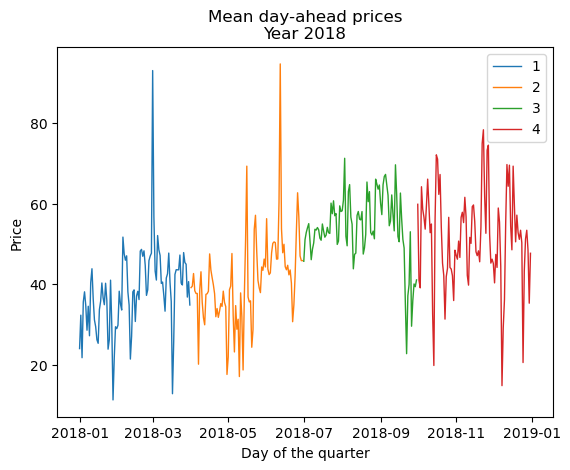

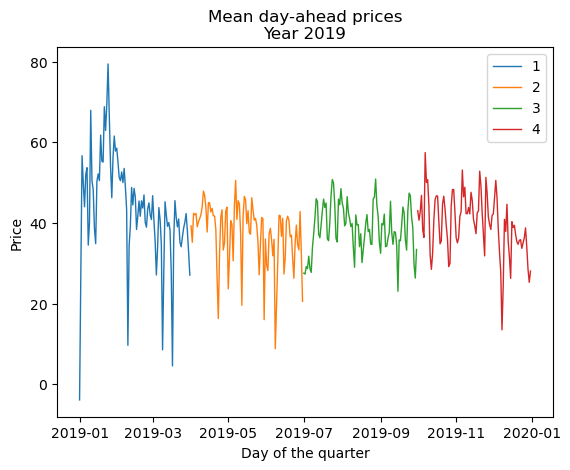

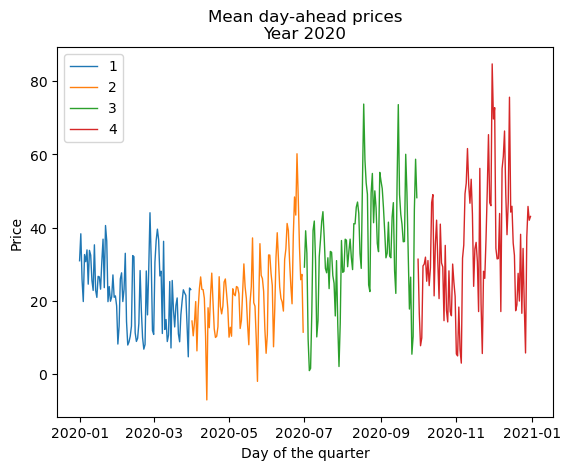

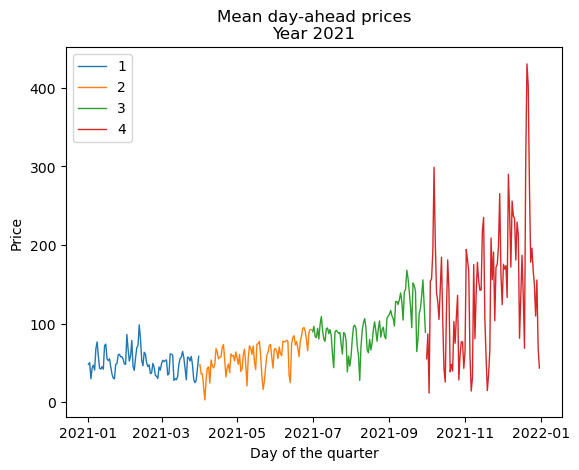

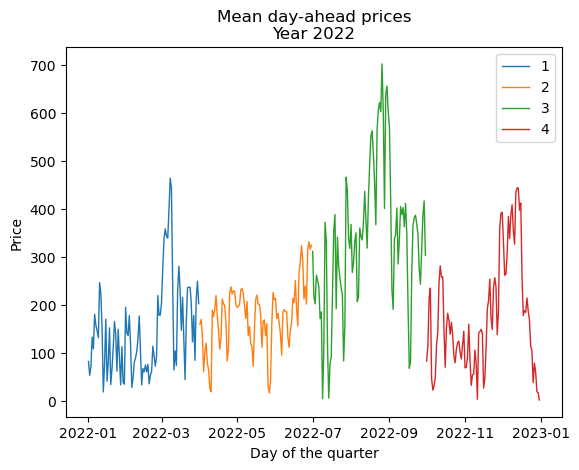

In [15]:
for y in years:
    for q in quarters:
        temp = df3[(df3['Year'] == y) & (df3['Quarter'] == q)].reset_index()
        plt.plot(temp['Date'], temp['Day-ahead prices'], linestyle = '-', linewidth = 1, label = q)
    plt.legend()
    plt.title('Mean day-ahead prices\nYear '+str(y))
    plt.xlabel('Day of the quarter')
    plt.ylabel('Price')
    plt.show()

In [16]:
df['Day-ahead prices'].notna().count()

43824

In [17]:
df[df['Day-ahead prices'] < 0]['Day-ahead prices'].count()

250

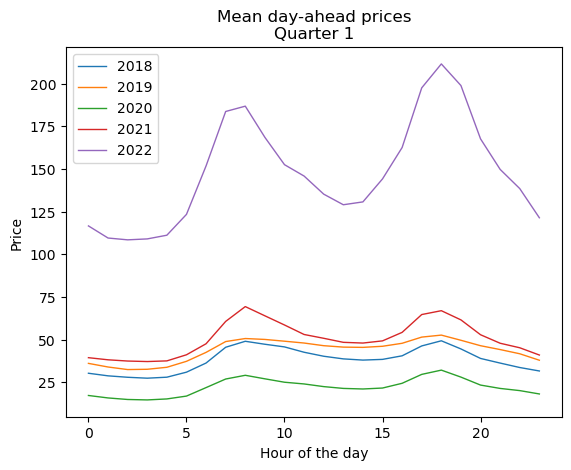

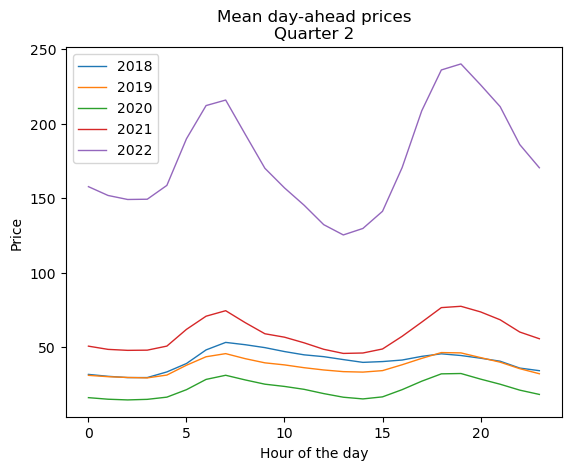

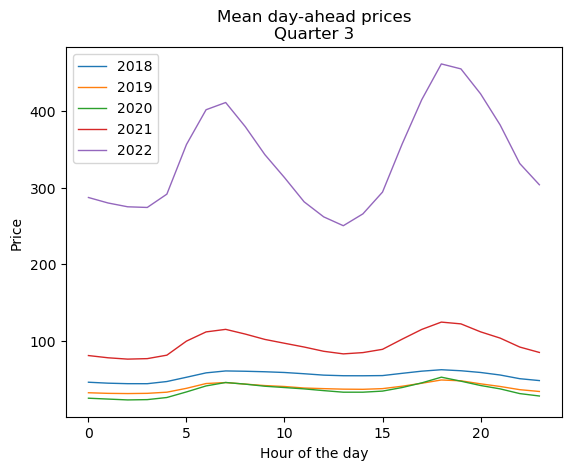

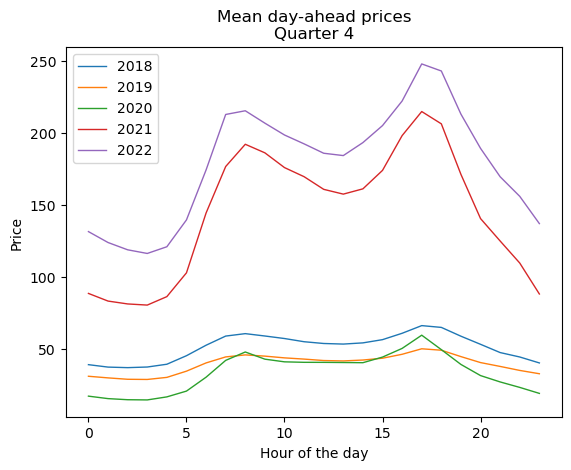

In [18]:
for q in quarters:
    for y in years:
        temp = df2[(df2['Year'] == y) & (df2['Quarter'] == q)].reset_index()
        temp = temp.groupby('Hour').mean(numeric_only = True)
        plt.plot(temp['Day-ahead prices'], linestyle = '-', linewidth = 1, label = y)
    plt.legend()
    plt.title('Mean day-ahead prices\nQuarter '+str(q))
    plt.xlabel('Hour of the day')
    plt.ylabel('Price')
    plt.show()

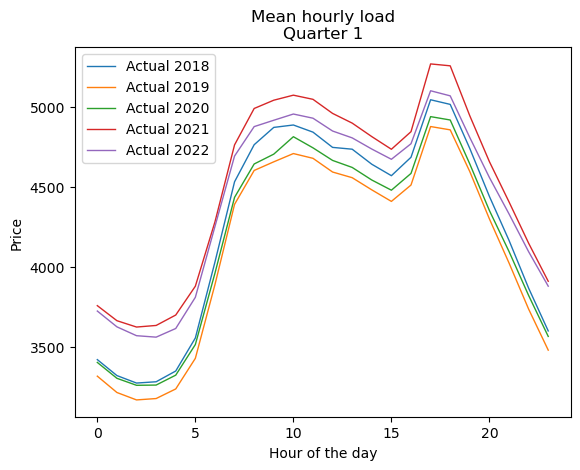

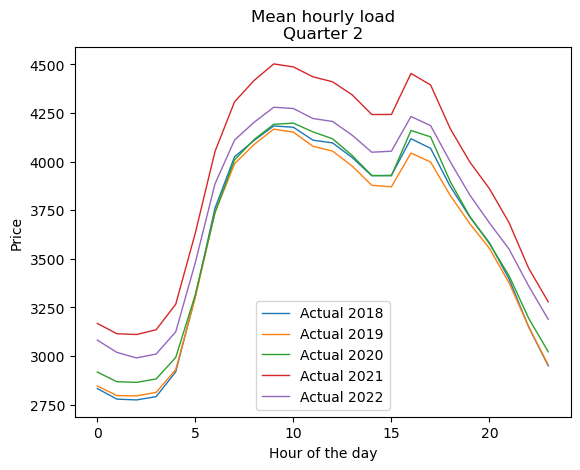

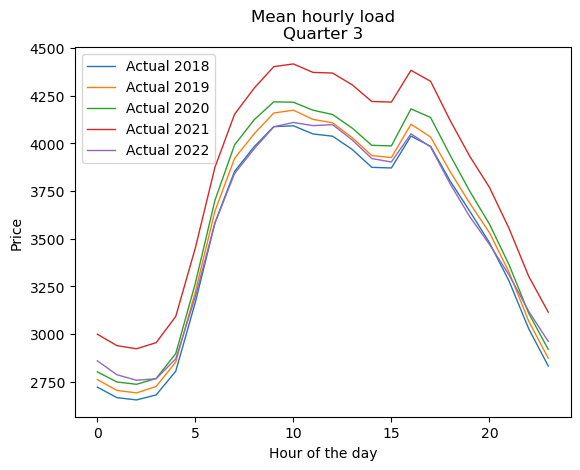

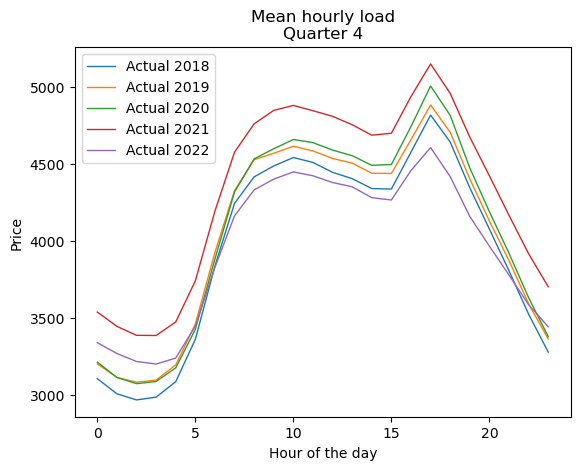

In [19]:
for q in quarters:
    for y in years:
        temp = df2[(df2['Year'] == y) & (df2['Quarter'] == q)].reset_index()
        temp = temp.groupby('Hour').mean(numeric_only = True)
        plt.plot(temp['Actual Load'], linestyle = '-', linewidth = 1, label = 'Actual ' + str(y))
#         plt.plot(temp['Forecasted Load'], linestyle = '--', linewidth = 1, label = 'Forecasted' + str(y))
    plt.legend()
    plt.title('Mean hourly load\nQuarter '+str(q))
    plt.xlabel('Hour of the day')
    plt.ylabel('Price')
    plt.show()

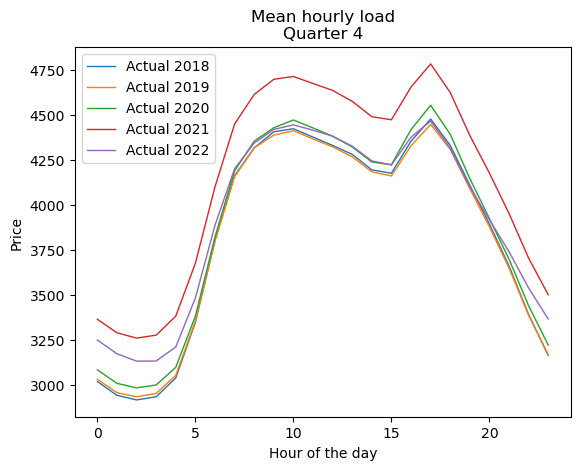

In [20]:
for y in years:
    temp = df2[(df2['Year'] == y)].reset_index()
    temp = temp.groupby('Hour').mean(numeric_only = True)
    plt.plot(temp['Actual Load'], linestyle = '-', linewidth = 1, label = 'Actual ' + str(y))
#     plt.plot(temp['Forecasted Load'], linestyle = '--', linewidth = 1, label = 'Forecasted' + str(y))
plt.legend()
plt.title('Mean hourly load\nQuarter '+str(q))
plt.xlabel('Hour of the day')
plt.ylabel('Price')
plt.show()

In [32]:
df2 = get_dt_info(df2, 'Date', w = True)

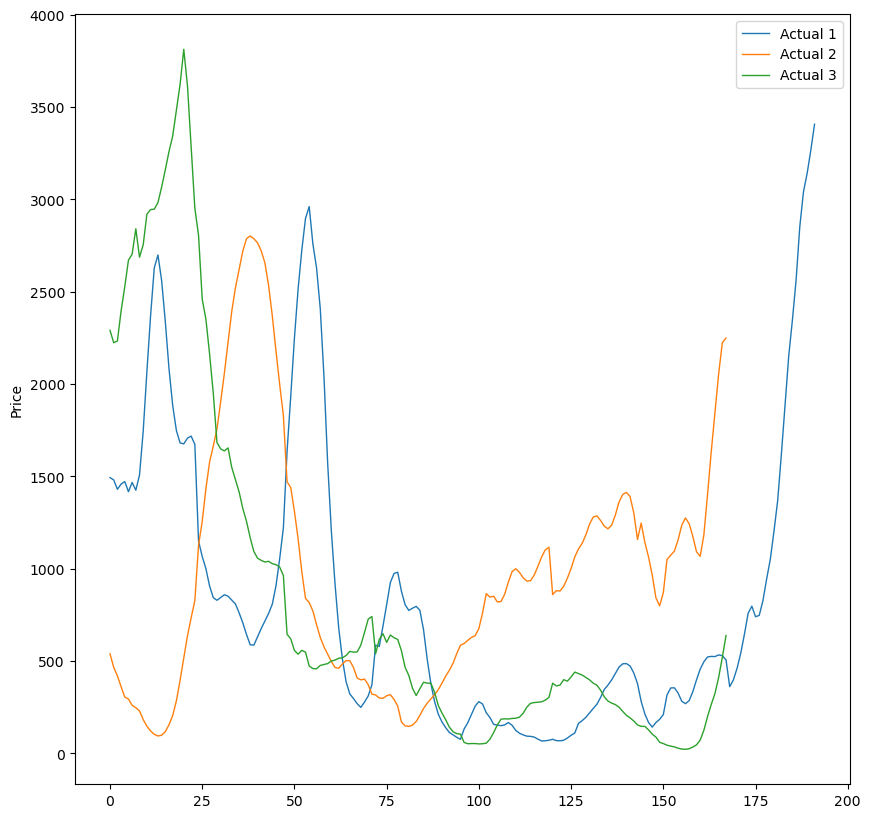

In [38]:
plt.figure(figsize=(10,10))
for w in range(1,4):
    temp = df2[(df2['Week'] == w) & (df['Year']  == 2018)].reset_index()
#     temp = temp.groupby('Hour').mean(numeric_only = True)
    plt.plot(temp['Wind Onshore'], linestyle = '-', linewidth = 1, label = 'Actual ' + str(w))
#     plt.plot(temp['Forecasted Load'], linestyle = '--', linewidth = 1, label = 'Forecasted' + str(y))
plt.legend()
# plt.title('Mean hourly load\nQuarter '+str(q))
# plt.xlabel('Hour of the day')
plt.ylabel('Price')
plt.show()

In [21]:
df4 = df2.set_index('Timestamp')

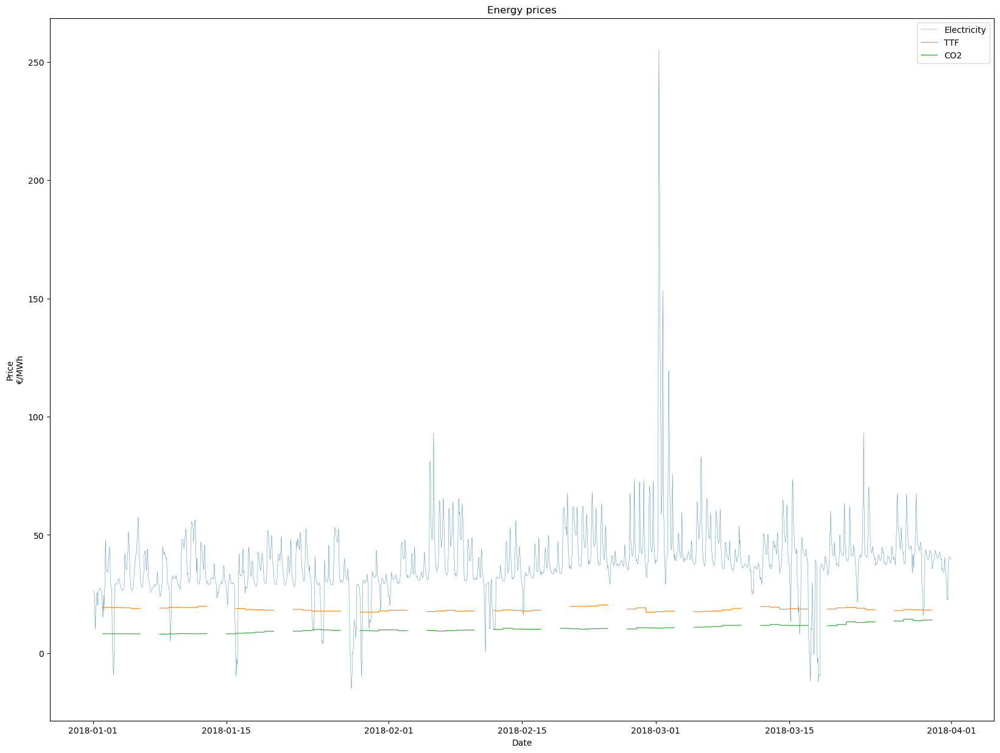

In [22]:
# Line chart of electricity price over time
plt.figure(figsize = (20,15))
plt.plot(df4.loc['2018-01':'2018-03']['Day-ahead prices'], linestyle = '-', linewidth = 0.3, label = 'Electricity')
plt.plot(df4.loc['2018-01':'2018-03']['TTF'], linestyle = '-', linewidth = 0.8, label = 'TTF')
plt.plot(df4.loc['2018-01':'2018-03']['CO2'], linestyle = '-', linewidth = 0.8, label = 'CO2')
# plt.plot(df2.loc['2018-01':'2018-03'].index, df2.loc['2018-01':'2018-03']['Day-ahead prices'], linestyle = '-', linewidth = 0.3, label = 'Electricity')
# plt.plot(df2.loc['2018-01':'2018-03'].index, df2.loc['2018-01':'2018-03']['TTF'], linestyle = '-', linewidth = 0.8, label = 'TTF')
# plt.plot(df2.loc['2018-01':'2018-03'].index, df2.loc['2018-01':'2018-03']['CO2'], linestyle = '-', linewidth = 0.8, label = 'CO2')
plt.legend()
plt.title('Energy prices')
plt.xlabel('Date')
plt.ylabel('Price\n€/MWh')
plt.show()

In [ ]:
df['diff1'] = df['Day-ahead prices'].diff(periods = 1)
tsaplots.plot_acf(df['diff1'].dropna(), lags = 168)

In [ ]:
df['diff24'] = df['Day-ahead prices'].diff(periods = 24)
tsaplots.plot_acf(df['diff24'].dropna(), lags = 24)

In [ ]:
tsaplots.plot_acf(df['Day-ahead prices'].dropna(), lags = 48)
# tsaplots.plot_pacf(df['Day-ahead prices'].dropna(), lags = 48)

In [ ]:
df_log = df[df['Day-ahead prices'] > 0].copy()
df_log['Day-ahead prices log'] = np.log(df_log['Day-ahead prices'])
tsaplots.plot_acf(df_log['Day-ahead prices log'].dropna(), lags = 48)

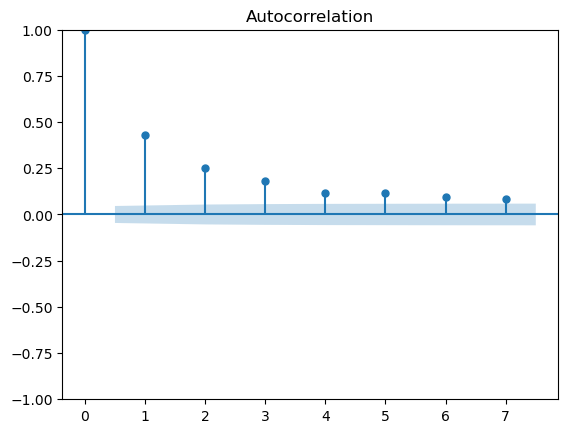

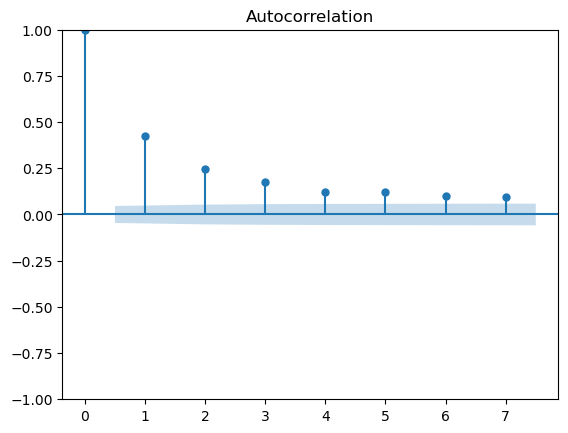

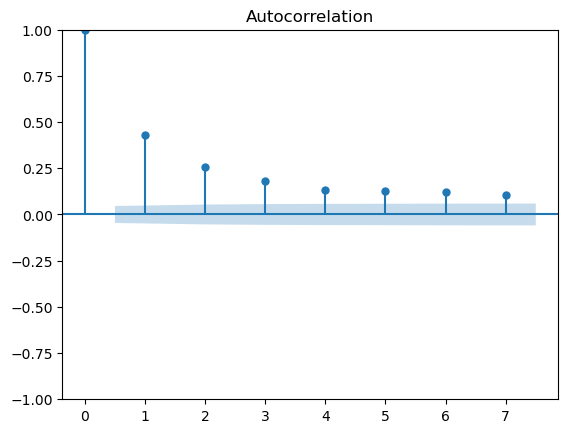

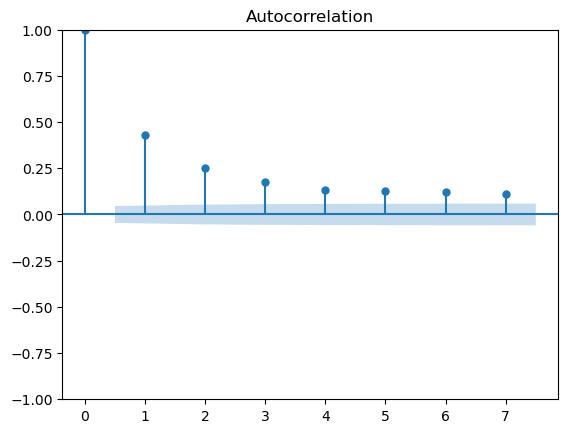

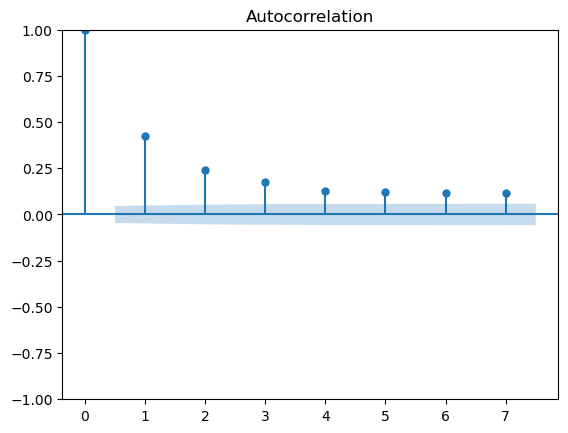

...

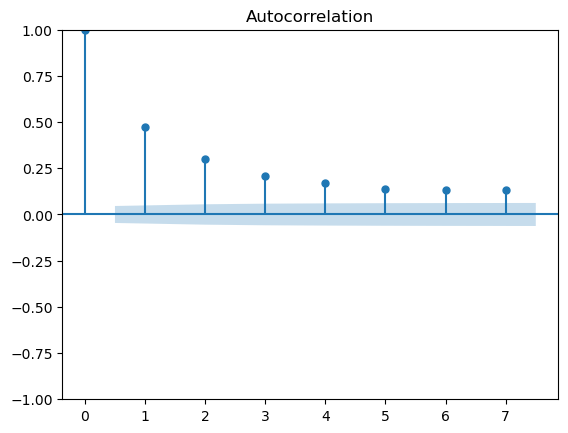

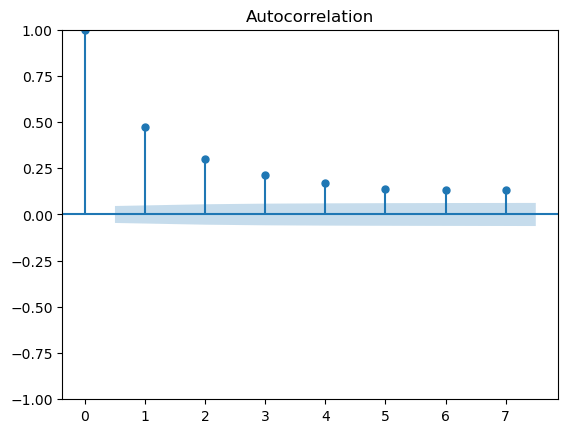

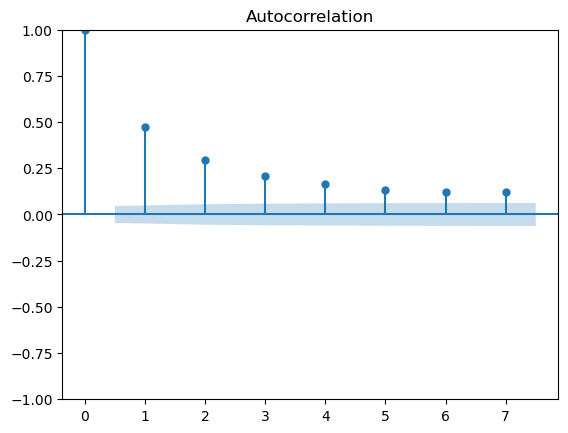

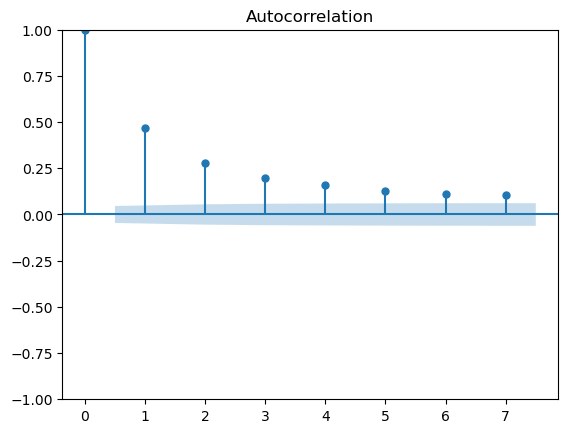

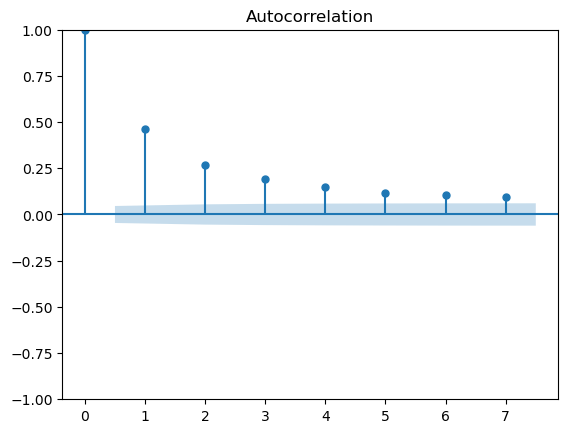

In [46]:
for i in range(23):
    tsaplots.plot_acf(df2[df2['Hour'] == i]['Wind Offshore'].dropna(), lags =7)

In [ ]:
# ONE PLOT PER YEAR?
# ASSIGN COLORS EACH YEAR?

# Scatter plot of electricity price and wind load
plt.scatter(df['Day-ahead prices'], df['Wind Total'], s = 0.5, c = df['Month'])
plt.xlabel('Day-ahead prices')
plt.ylabel('Wind Load')
plt.title('Electricity Price vs Wind Load')
plt.show()


In [ ]:
# Scatter plot of electricity price and wind load
df_masked = df[df['Year'] != 2022]
plt.scatter(df_masked['Day-ahead prices'], df_masked['Wind Total'], s = 0.5, c = df_masked['Year'])
plt.xlabel('Day-ahead prices')
plt.ylabel('Wind Load')
plt.title('Electricity Price vs Wind Load')
plt.show()

In [ ]:
# DISAGGREGATE PER YEAR
# Bar chart of average electricity price for each month
monthly_average = df.groupby(by = 'Month')['Day-ahead prices'].mean()
plt.bar(monthly_average.index, monthly_average.values)
plt.xticks(range(1, 13))
plt.xlabel('Month')
plt.ylabel('Average Electricity Price')
plt.title('Average Electricity Price by Month')
plt.show()

In [ ]:
# WHAT'S THAT
# Select random month
random_month = np.random.randint(1, 13)

# Filter data for the selected month
df_month = df[df['Month'] == random_month]

# Heatmap of correlations between variables
sns.heatmap(df_month.corr(), annot=True, cmap='coolwarm')
plt.title(f'Correlation Heatmap for {random_month}/{df_month["Year"].iloc[0]}')
plt.show()

In [ ]:
# ONE PLOT WITH 4/5 BOXES, ONE PER YEAR
# Boxplot of electricity prices for the selected month
sns.boxplot(y=df_month[df_month['Year'] != 2022]['Day-ahead prices'])
plt.title(f'Boxplot of Electricity Prices for {random_month}/{df_month["Year"].iloc[0]}') # CHANGE TITLE
plt.ylabel('Day-ahead prices')
plt.show()

In [ ]:
# Boxplot of electricity prices for the selected month
sns.boxplot(y=df_month['Day-ahead prices'])
plt.title(f'Boxplot of Electricity Prices for {random_month}/{df_month["Year"].iloc[0]}') # CHANGE TITLE
plt.ylabel('Day-ahead prices')
plt.show()

In [ ]:
# group the data by hour and calculate the mean of the 'total load' column
hourly_avg_load = df.groupby('Hour')['Actual Load'].mean()
hourly_avg_price = df.groupby('Hour')['Day-ahead prices'].mean()

In [ ]:
# groupby hour and year
# secondary axis
# plot the hourly average total load
plt.plot(hourly_avg_load.index, hourly_avg_load.values, label = 'Actual Load')
plt.plot(hourly_avg_price.index, hourly_avg_price.values, label = 'Prices')
plt.xlabel('Hour')
plt.title('Hourly Average Total Load')
plt.legend()
plt.show()